# Example of GRSl2bgen processing

In [28]:


import os
import glob

import matplotlib as mpl
import matplotlib.pyplot as plt
rc = {"font.family": "serif",
      "mathtext.fontset": "stix"}
plt.rcParams.update(rc)
plt.rcParams["font.serif"] = ["Times New Roman"] + plt.rcParams["font.serif"]
plt.rcParams.update({'font.size': 18, 'axes.labelsize': 18})


import numpy as np
import xarray as xr
import rioxarray as rio
import pandas as pd

import cartopy.crs as ccrs

import GRSl2bgen
import grstbx 

opj = os.path.join

print(f'-GRSl2bgen: {GRSl2bgen.__version__}')

-GRSl2bgen: 0.0.2


### Load your L2A image

In [2]:
l2a_path = '/data/satellite/Sentinel-2/L2A/30TWT/2017/04/12/S2A_MSIL2A_20170412T110621_N0500_R137_T30TWT_20231111T110836/S2A_MSIL2A_20170412T110621_N0500_R137_T30TWT_20231111T110836.nc'
raster = xr.open_dataset(l2a_path,decode_coords='all')

In [3]:
raster['Rrs'] = raster.Rrs.where(raster.mask==0)
str_epsg = str(raster.rio.crs)
zone = str_epsg[-2:]
is_south = str_epsg[2] == 7
proj = ccrs.UTM(zone, is_south)

### Visualize and subset your region of interest

In [4]:

v=grstbx.visual.ViewSpectral(raster.Rrs,reproject=True)
v.minmax=[0,0.1]
v.minmaxvalues=(0,0.04)
v.visu()

Column
    [0] WidgetBox
        [0] Markdown(str)
        [1] Column
            [0] Row
                [0] Markdown(str)
                [1] RadioButtonGroup(options=[0, 1, 2, 3, 4, ...], value=2)
            [1] Row
                [0] Row
                    [0] Markdown(str)
                    [1] DatePicker(enabled_dates=[datetime.date(2017, ...], start=datetime.date(2017, ..., value=datetime.date(2017, ...)
                [1] Row
                    [0] Markdown(str)
                    [1] Select(options=['CartoDark', ...], value='CartoDark')
            [2] Row
                [0] Row
                    [0] Markdown(str)
                    [1] EditableRangeSlider(end=0.1, name='Range Slider', step=0.0001, value=(0, 0.04), width=300)
                [1] Row
                    [0] Markdown(str)
                    [1] FloatSlider(name='Opacity', step=0.05, value=0.95)
                [2] Row
                    [0] Markdown(str)
                    [1] Select(options=['CET_D13', 'bky', ...], value='CET_D13')
        [2] HoloViews(Layout)

In [5]:
geom_ = v.get_geom(v.aoi_stream,crs=raster.rio.crs)

clipped = raster.rio.clip(geom_.geometry.values).load()

/home/harmel/anaconda3/envs/py12/lib/python3.12/site-packages/xarray/core/duck_array_ops.py:230: RuntimeWarning: invalid value encountered in cast
  return data.astype(dtype, **kwargs)
/home/harmel/anaconda3/envs/py12/lib/python3.12/site-packages/xarray/core/duck_array_ops.py:230: RuntimeWarning: invalid value encountered in cast
  return data.astype(dtype, **kwargs)


### Check standard OWT libraries

(<Figure size 900x600 with 1 Axes>,
 <Axes: xlabel='$Wavelength\\ (nm)$', ylabel='$Standardized\\ R_{rs}\\ (nm^{-1})$'>)

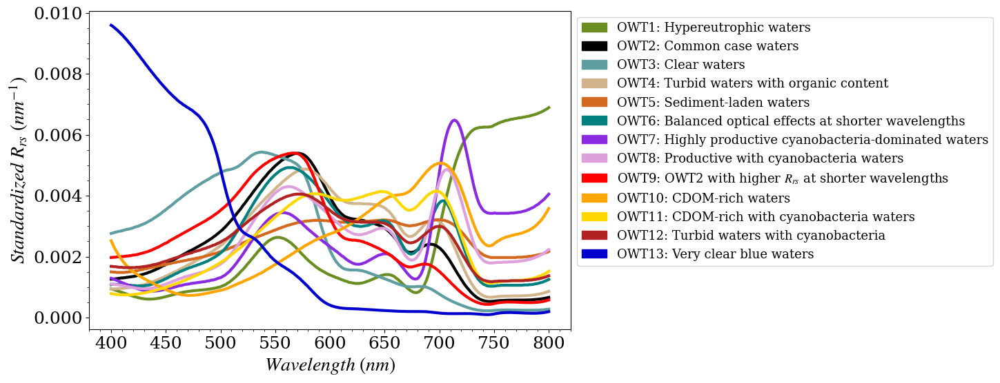

In [29]:
# By default Spyroakos et al, 2018
OWT = GRSl2bgen.OWT(raster)
OWT.plot()

(<Figure size 900x600 with 1 Axes>,
 <Axes: xlabel='$Wavelength\\ (nm)$', ylabel='$R_{rs}\\ (sr^{-1})$'>)

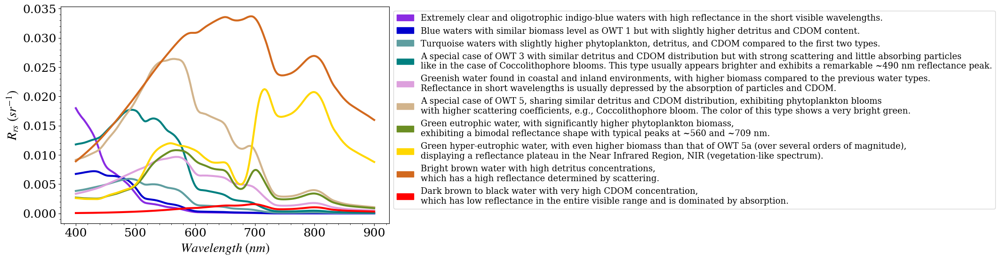

In [30]:
OWT = GRSl2bgen.OWT(raster,owt_database='Bi2024',param='m_Rrs')
OWT.plot()

### Apply those OWT dataset to your L2A image

INFO:root:OWT classification
INFO:root:success
INFO:root:construct xarray owt product
INFO:root:OWT classification
INFO:root:success
INFO:root:construct xarray owt product


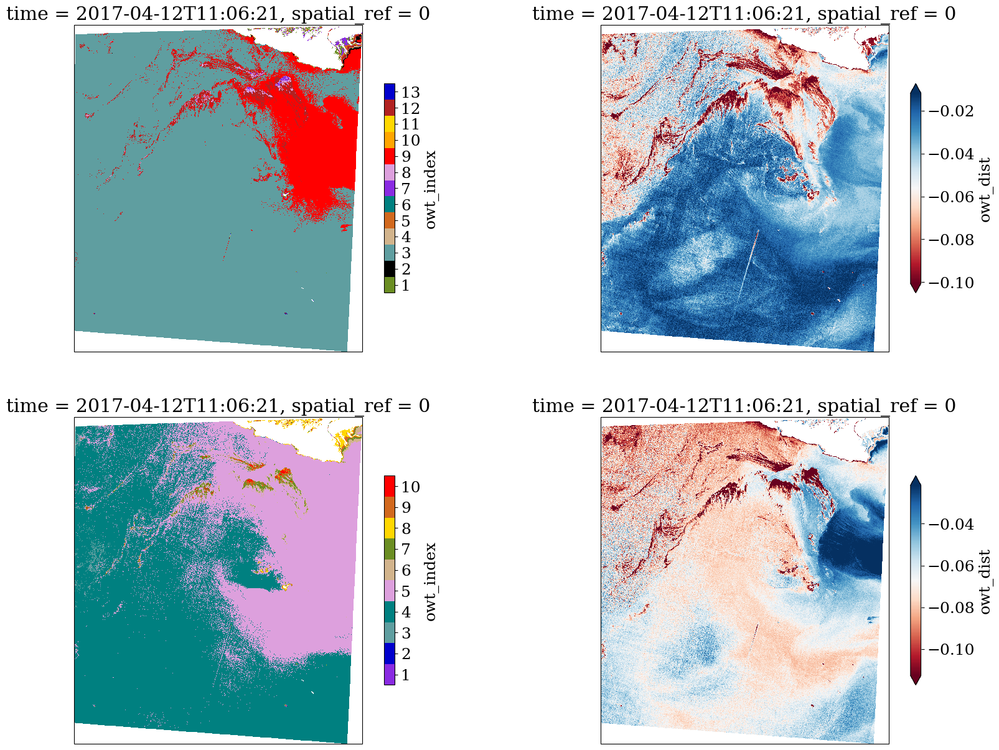

In [32]:
str_epsg = str(raster.rio.crs)
zone = str_epsg[-2:]
is_south = str_epsg[2] == 7
proj = ccrs.UTM(zone, is_south)

fig = plt.figure(figsize=(20, 15))
OWT = GRSl2bgen.OWT(clipped,owt_database='Spyrakos2018')
xowt = OWT.multi_process()
ax = plt.subplot(2, 2, 1, projection=proj)
xowt.owt_index.plot.imshow(vmin=0.5,vmax=OWT.Nowt+.5,cmap=OWT.cmap_owt,cbar_kwargs={ 'ticks':range(1,14),'shrink': 0.64},ax=ax)

cmap = plt.get_cmap('RdBu')#,13)
ax = plt.subplot(2, 2, 2, projection=proj)
xowt.owt_dist.plot.imshow(robust=True,cmap=cmap,ax=ax, cbar_kwargs={ 'shrink': 0.64})

OWT = GRSl2bgen.OWT(clipped,owt_database='Bi2024')
xowt = OWT.multi_process()
ax = plt.subplot(2, 2, 3, projection=proj)
xowt.owt_index.plot.imshow(vmin=0.5,vmax=OWT.Nowt+.5,cmap=OWT.cmap_owt,cbar_kwargs={ 'ticks':range(1,14),'shrink': 0.64},ax=ax)

cmap = plt.get_cmap('RdBu')#,13)
ax = plt.subplot(2, 2, 4, projection=proj)
xowt.owt_dist.plot.imshow(robust=True,cmap=cmap,ax=ax, cbar_kwargs={ 'shrink': 0.64})

### Test other OWT datasets 

In [44]:
hablab_owts = xr.open_dataset('/DATA/data/model/owt/hablab_owt_chl20_chl_200.nc')#.drop_sel(species=['MIC','EMI'])
hablab_owts

<xarray.Dataset> Size: 228kB
Dimensions:   (species: 14, chl: 2, wl: 500)
Coordinates:
  * species   (species) <U3 168B 'ALM' 'ALX' 'CHA' 'EMI' ... 'PRO' 'PRY' 'TEL'
  * chl       (chl) int64 16B 20 200
  * wl        (wl) int64 4kB 400 401 402 403 404 405 ... 894 895 896 897 898 899
Data variables:
    Rrs_elas  (species, chl, wl) float64 112kB ...
    Rrs_tot   (species, chl, wl) float64 112kB ...
Attributes:
    fwhm:         10
    acdom440:     0.2
    spm_norm:     0.35
    description:  remote sensing reflectance from HABLAB IOP and InvRrs modeling
    unit:         sr-1

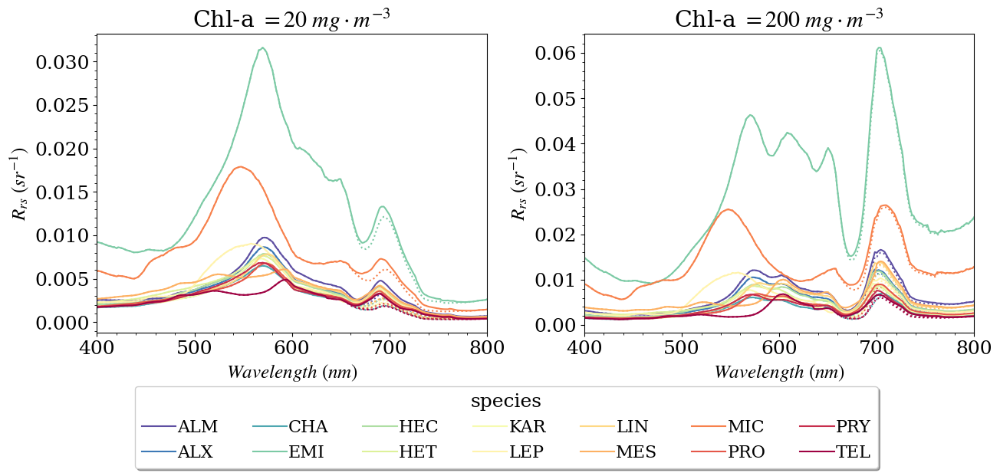

In [45]:


cmap = plt.cm.Spectral_r
def modify_legend(axes, **kwargs):
    oldleg = axes.get_legend()
    props = dict(
        handles=oldleg.legend_handles,
        labels=[t.get_text() for t in oldleg.texts],
        title=oldleg.get_title().get_text()
    )
    props.update(kwargs) # kwargs takes precedence over props
    axes.legend(**props)
    return

rows=1
cols=2
Nspecies=len(hablab_owts.species)
fig, axs = plt.subplots(rows,cols, figsize=(cols*6+1, rows * 4+1.) )
fig.subplots_adjust(hspace=0.24, wspace=0.25,left=0.085, right=0.965,bottom=0.12, top=0.9) 

for ax in axs:
    ax.set_prop_cycle('color', cmap(np.linspace(0, 1, Nspecies)))
    
ii=0
ax=axs[ii]
hablab_owts.isel(chl=ii).Rrs_elas.plot(hue='species',ls=':',ax=axs[ii],add_legend=False)
hablab_owts.isel(chl=ii).Rrs_tot.plot(hue='species',ax=axs[ii],add_legend=False)
ax.set_title(r'Chl-a $= 20\ mg\cdot m^{-3}$')  
ii=1
ax=axs[ii]
hablab_owts.isel(chl=ii).Rrs_elas.plot(hue='species',ls=':',ax=axs[ii],add_legend=False)
hablab_owts.isel(chl=ii).Rrs_tot.plot(hue='species',ax=axs[ii])   
ax.set_title(r'Chl-a $= 200\ mg\cdot m^{-3}$')

for ii,ax in enumerate(axs):
   
    #r'$a_{cdom}=$'+str(acdom440[ii])+r' $m^{-1}$')#r'n='+str(nr)+str(ni_ref)+'i')
    ax.minorticks_on()
    ax.set_xlabel(r'$Wavelength\ (nm)$')
    ax.set_ylabel(r'$R_{rs}\ (sr^{-1})$')
    ax.set_xlim(400,800)

modify_legend(axs[1],loc='upper center', bbox_to_anchor=(-0.2, -0.15),
                       fancybox=True, shadow=True, ncol=7, handletextpad=0.1, fontsize=16)

plt.show()

In [57]:
OWT = GRSl2bgen.OWT(clipped,owt_database='Bi2024')
xowt = hablab_owts.sel(chl=200).squeeze().rename({'species':'owt'}).Rrs_tot
xowt = xr.concat([xowt,OWT.owt.interp(wl=xowt.wl)],dim='owt').dropna('wl')

xowt

<xarray.DataArray 'Rrs_tot' (owt: 24, wl: 421)> Size: 81kB
array([[0.00311123, 0.0031124 , 0.00311349, ..., 0.0047872 , 0.00490081,
        0.00498996],
       [0.00223775, 0.00221761, 0.00219745, ..., 0.00300351, 0.00298462,
        0.00295145],
       [0.0015213 , 0.0015134 , 0.0015055 , ..., 0.00217234, 0.00223296,
        0.00228188],
       ...,
       [0.00140979, 0.00140458, 0.00139938, ..., 0.01086085, 0.01068789,
        0.01051492],
       [0.00152733, 0.00154155, 0.00155577, ..., 0.00429759, 0.00425864,
        0.00421968],
       [0.00064954, 0.00065577, 0.000662  , ..., 0.00494654, 0.00483825,
        0.00472996]])
Coordinates:
  * owt      (owt) <U21 2kB 'ALM' 'ALX' 'CHA' 'EMI' 'HEC' ... '7' '8' '9' '10'
    chl      int64 8B 200
  * wl       (wl) int64 3kB 400 401 402 403 404 405 ... 815 816 817 818 819 820

In [58]:
OWT = GRSl2bgen.OWT(clipped,xowt=xowt)
xowt_prod = OWT.multi_process()

INFO:root:OWT classification
INFO:root:success
INFO:root:construct xarray owt product


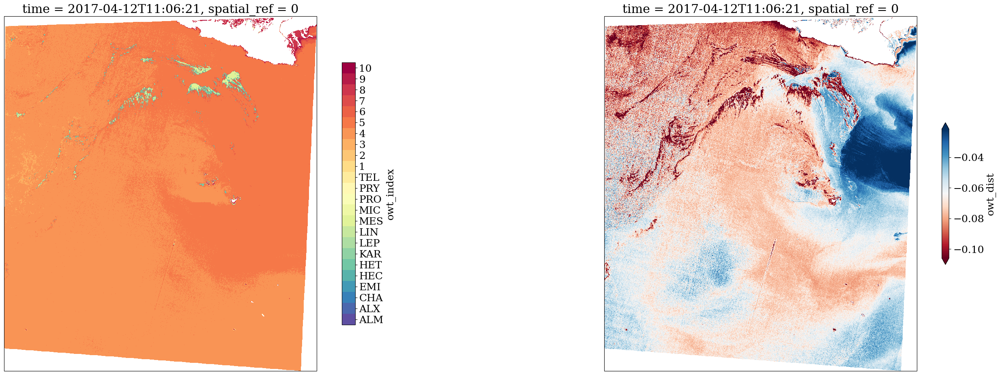

In [59]:

fig = plt.figure(figsize=(35, 25))
# get discrete colormap
cmap = plt.get_cmap('Spectral_r', len(xowt.owt.values))
Nowt = len(xowt.owt.values)
ax = plt.subplot(2, 2, 1, projection=proj)
cb = xowt_prod.owt_index.plot.imshow(cmap=cmap,vmin=0.5,vmax=Nowt+0.5,cbar_kwargs={'ticks':range(1,Nowt+1), 'shrink': 0.74},ax=ax)
cb.colorbar.ax.set_yticklabels(xowt.owt.values)
cmap = plt.get_cmap('RdBu')#,13)
ax = plt.subplot(2, 2, 2, projection=proj)
xowt_prod.owt_dist.plot.imshow(robust=True,cmap=cmap,ax=ax, cbar_kwargs={ 'shrink': 0.4})

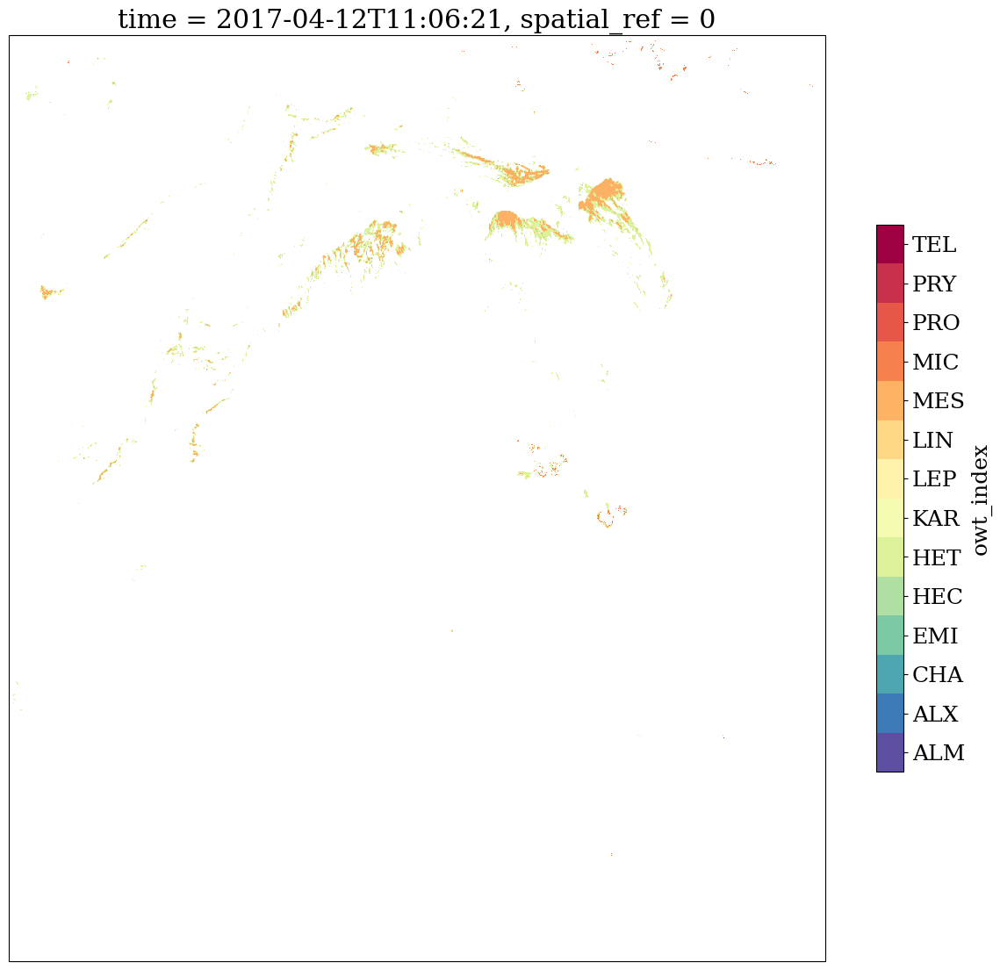

In [60]:
plt.figure(figsize=(15,15))
Nowt=14
cmap = plt.get_cmap('Spectral_r', Nowt)
cb=xowt_prod.owt_index.where(xowt_prod.owt_index<Nowt+1).plot.imshow(vmin=0.5,vmax=Nowt+0.5,cmap=cmap,cbar_kwargs={'ticks':range(1,Nowt+1), 'shrink': 0.54},subplot_kws=dict(projection=proj))
cb.colorbar.ax.set_yticklabels(xowt.owt.values[:Nowt])
plt.show()

### Quick interactive check

In [16]:

import hvplot
import hvplot.xarray
#xowt_prod.owt_dist.hvplot( cmap="RdYlBu_r",clim=(-0.12,0))
xowt_prod.hvplot.explorer(
    cmap="RdYlBu_r",height=600,width=700,clim=(-0.12,0))


hvGridExplorer(advanced=Advanced(explorer=..., name='Advanced01530', opts=None), axes=Axes(explorer=..., height=600, legend='bottom_right', logx=False, logy=False, name='Axes01524', responsive=True, shared_axes=True, width=700, xlim=None, ylim=None), by=[], code="ds.to_array('variable').transpose(..., 'variable').hvplot(\n    clim=(-0.12, 0),\n    cmap='RdYlBu_r',\n    groupby=['variable'],\n    height=600,\n    kind='image',\n    width=700,\n    x='x',\n    y='y',\n    legend='bottom_right',\n    widget_location='bottom',\n)", colormapping=Colormapping(clim=(-0.12, 0), cmap='RdYlBu_r', cnorm='linear', color=None, colorbar=None, explorer=..., name='Colormapping01525', rescale_discrete_levels=True, symmetric=False), geographic=Geographic(crs=None, crs_kwargs={}, explorer=..., feature_scale='110m', features=None, geo=False, global_extent=None, name='Geographic01527', project=False, projection=None, projection_kwargs={}, tiles=None), groupby=['variable'], kind='image', labels=Labels(clabel='', explorer=..., fontscale=1, name='Labels01526', rot=0, title='', xlabel='', ylabel=''), name='hvGridExplorer01502', operations=Operations(aggregator=None, datashade=False, dynspread=False, explorer=..., name='Operations01528', rasterize=False, x_sampling=None, y_sampling=None), statusbar=StatusBar(live_update=True, name='StatusBar01517'), style=Style(alpha=1, explorer=..., name='Style01529'), x='x', y='y', y_multi=[None])

### Now you can try to tweak your OWT

In [54]:
OWT = GRSl2bgen.OWT(clipped,owt_database='Bi2024')
xowt = hablab_owts.sel(chl=200).squeeze().rename({'species':'owt'}).Rrs_tot.sel(owt=['MES'])
xowt = xr.concat([xowt,OWT.owt.interp(wl=xowt.wl)],dim='owt').dropna('wl')

xowt

<xarray.DataArray 'Rrs_tot' (owt: 11, wl: 421)> Size: 37kB
array([[3.87963913e-03, 3.85014671e-03, 3.82039939e-03, ...,
        3.92275188e-03, 3.91616331e-03, 3.89067246e-03],
       [2.30629493e-02, 2.28492228e-02, 2.26354962e-02, ...,
        2.27548616e-05, 2.21792709e-05, 2.16036803e-05],
       [1.14689857e-02, 1.14962674e-02, 1.15235492e-02, ...,
        3.47340607e-05, 3.38498320e-05, 3.29656032e-05],
       ...,
       [1.40978763e-03, 1.40458136e-03, 1.39937510e-03, ...,
        1.08608525e-02, 1.06878856e-02, 1.05149186e-02],
       [1.52732895e-03, 1.54154989e-03, 1.55577083e-03, ...,
        4.29759121e-03, 4.25863580e-03, 4.21968039e-03],
       [6.49536640e-04, 6.55769602e-04, 6.62002564e-04, ...,
        4.94654091e-03, 4.83824933e-03, 4.72995774e-03]])
Coordinates:
  * owt      (owt) <U21 924B 'MES' '1' '2' '3' '4' '5' '6' '7' '8' '9' '10'
    chl      int64 8B 200
  * wl       (wl) int64 3kB 400 401 402 403 404 405 ... 815 816 817 818 819 820

INFO:root:OWT classification
INFO:root:success
INFO:root:construct xarray owt product


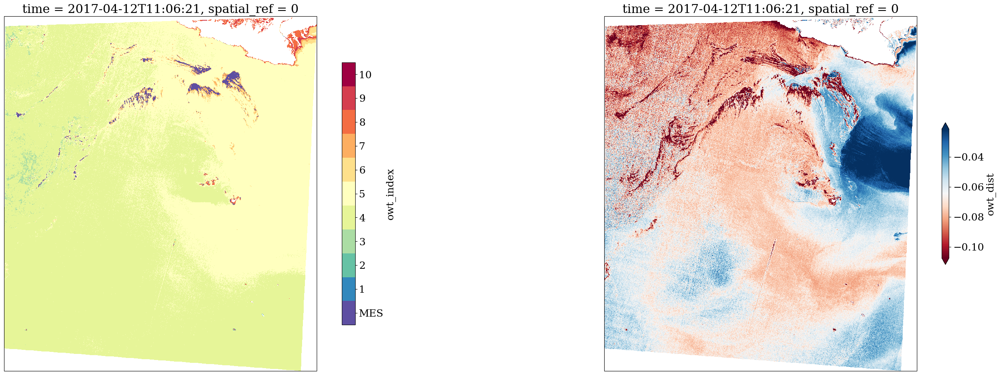

In [55]:
OWT = GRSl2bgen.OWT(clipped,xowt=xowt)
xowt_prod = OWT.multi_process()

fig = plt.figure(figsize=(35, 25))
# get discrete colormap
cmap = plt.get_cmap('Spectral_r', len(xowt.owt.values))
Nowt = len(xowt.owt.values)
ax = plt.subplot(2, 2, 1, projection=proj)
cb = xowt_prod.owt_index.plot.imshow(cmap=cmap,vmin=0.5,vmax=Nowt+0.5,cbar_kwargs={'ticks':range(1,Nowt+1), 'shrink': 0.74},ax=ax)
cb.colorbar.ax.set_yticklabels(xowt.owt.values)
cmap = plt.get_cmap('RdBu')#,13)
ax = plt.subplot(2, 2, 2, projection=proj)
xowt_prod.owt_dist.plot.imshow(robust=True,cmap=cmap,ax=ax, cbar_kwargs={ 'shrink': 0.4})

### You can also proceed with advanced settings
1. choice of the spectral range 

INFO:root:OWT classification
INFO:root:success
INFO:root:construct xarray owt product


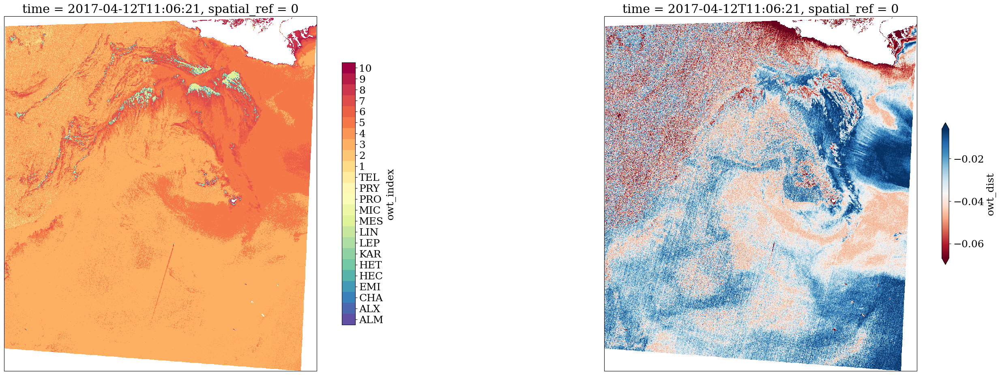

In [61]:
OWT = GRSl2bgen.OWT(clipped,xowt=xowt,wl_range=slice(550,740))
xowt_prod = OWT.multi_process()

fig = plt.figure(figsize=(35, 25))
# get discrete colormap
cmap = plt.get_cmap('Spectral_r', len(xowt.owt.values))
Nowt = len(xowt.owt.values)
ax = plt.subplot(2, 2, 1, projection=proj)
cb = xowt_prod.owt_index.plot.imshow(cmap=cmap,vmin=0.5,vmax=Nowt+0.5,cbar_kwargs={'ticks':range(1,Nowt+1), 'shrink': 0.74},ax=ax)
cb.colorbar.ax.set_yticklabels(xowt.owt.values)
cmap = plt.get_cmap('RdBu')#,13)
ax = plt.subplot(2, 2, 2, projection=proj)
xowt_prod.owt_dist.plot.imshow(robust=True,cmap=cmap,ax=ax, cbar_kwargs={ 'shrink': 0.4})

2. or for specified bands

INFO:root:OWT classification
INFO:root:success
INFO:root:construct xarray owt product


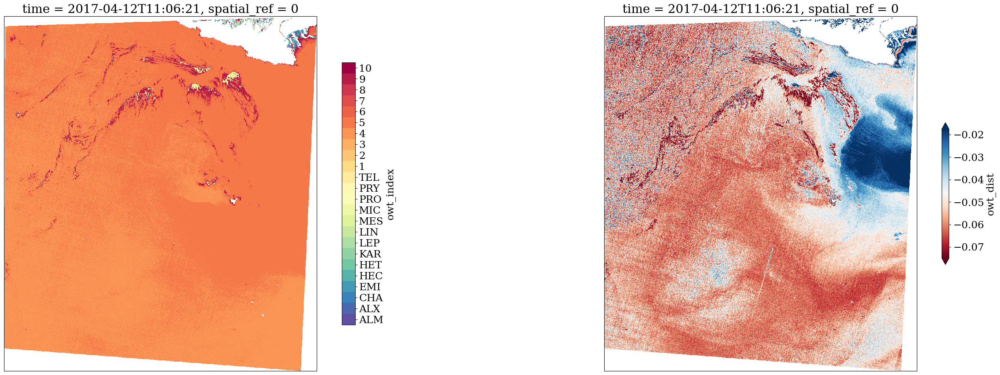

In [62]:
OWT = GRSl2bgen.OWT(clipped.sel(wl=[490,565,690],method='nearest'),xowt=xowt)
xowt_prod = OWT.multi_process()

fig = plt.figure(figsize=(35, 25))
# get discrete colormap
cmap = plt.get_cmap('Spectral_r', len(xowt.owt.values))
Nowt = len(xowt.owt.values)
ax = plt.subplot(2, 2, 1, projection=proj)
cb = xowt_prod.owt_index.plot.imshow(cmap=cmap,vmin=0.5,vmax=Nowt+0.5,cbar_kwargs={'ticks':range(1,Nowt+1), 'shrink': 0.74},ax=ax)
cb.colorbar.ax.set_yticklabels(xowt.owt.values)
cmap = plt.get_cmap('RdBu')#,13)
ax = plt.subplot(2, 2, 2, projection=proj)
xowt_prod.owt_dist.plot.imshow(robust=True,cmap=cmap,ax=ax, cbar_kwargs={ 'shrink': 0.4})